<p align="center">
<a href="https://github.com/jina-ai/dalle"><img src="https://res.cloudinary.com/startup-grind/image/upload/c_fill,dpr_2.0,f_auto,g_xy_center,h_650,q_auto:good,w_1440,x_w_mul_0.5,y_h_mul_0.0/v1/gcs/platform-data-dsc/event_banners/banner_8XSoAdr.png?md" alt="DALL·E Flow: A Human-in-the-Loop workflow for creating HD images from text" width="100%"></a>
<br>
</p>


<b>A Human-in-the-Loop<sup><a href="https://en.wikipedia.org/wiki/Human-in-the-loop">?</a></sup> workflow for creating HD images from text</b>

[![GitHub Repo stars](https://img.shields.io/github/stars/jina-ai/dalle-flow?style=social)](https://github.com/jina-ai/dalle-flow) [![Google Colab](https://img.shields.io/badge/Slack-2.8k-blueviolet?logo=slack&amp;logoColor=white&style=flat-square)](https://slack.jina.ai) [![GitHub last commit (branch)](https://img.shields.io/github/last-commit/jina-ai/dalle-flow/main)](https://colab.research.google.com/github/jina-ai/dalle-flow/blob/main/client.ipynb)



🚧 If you find your request fails, it is possible the server is occasionally down for maintaince. Please give it a try in 5 minutes.

- ⚠️ **2022/7/6** Due to server migration to AWS EKS, server url changed to `grpcs://dalle-flow.dev.jina.ai`. All connections are now with TLS again, [Please _reopen_ the notebook in Google Colab!](https://colab.research.google.com/github/jina-ai/dalle-flow/blob/main/client.ipynb)
- ⚠️ **2022/6/25** Unexpected downtime between 6/25 0:00 - 12:00 CET due to out of GPU quotas. The new server now has 2 GPUs, add healthcheck.
- 2022/6/3 Reduce default number of images to 2 per pathway, 4 for diffusion.
- ⚠️ 2022/5/23 Fix an upstream bug in CLIP-as-service. This bug makes the 2nd diffusion step irrelevant to the given texts. New Dockerfile proved to be reproducible on a AWS EC2 `p2.x8large` instance.
- 2022/5/13b Removing TLS as Cloudflare gives 100s timeout, making DALLE Flow in usable [Please _reopen_ the notebook in Google Colab!](https://colab.research.google.com/github/jina-ai/dalle-flow/blob/main/client.ipynb).
- 🔐 2022/5/13 New Mega checkpoint! All connections are now with TLS, [Please _reopen_ the notebook in Google Colab!](https://colab.research.google.com/github/jina-ai/dalle-flow/blob/main/client.ipynb).
- 🌟 2022/5/10 [A Dockerfile is added! Now you can easily deploy your own DALL·E Flow](https://github.com/jina-ai/dalle-flow). New Mega checkpoint! Smaller memory-footprint, the whole Flow can now fit into **one GPU with 21GB memory**.
- 🌟 2022/5/9 Less memory-footprint overall, the whole Flow can now fit into one GPU with 18GB memory!
- 🌟 2022/5/7 DALL·E Flow just got updated!
    - New DALL·E Mega checkpoint
    - Improved GLID3 memory-efficiency and parameters
- 🌟 2022/5/6 DALL·E Flow just got updated!
    - The first step will generate 16 candidates: **8 from DALL·E Mega, 8 from GLID3-XL**; ranked by CLIP-as-service.
    - Optimized the flow efficiency, diffusion and upscaling is much faster now!
- ~~⚠️ 2022/5/3 **The number of images is restrict to 9 for DALL·E Mega, and 16 for GLID3-XL**~~
- ⚠️ 2022/5/2 **Due to the massive requests now, the server is super busy.** You can deploy your own server by following [the instruction here](https://github.com/jina-ai/dalle-flow#server).


Using client is super easy. The following steps are best run in Jupyter notebook or [Google Colab](https://colab.research.google.com/github/jina-ai/dalle-flow/blob/main/client.ipynb).  

The only dependency you will need are [DocArray](https://github.com/jina-ai/docarray) and [Jina](https://github.com/jina-ai/jina), as DocArray is already included in Jina you only need to install `jina`.

> On Google Colab, you will be asked to restart the kernel. Go ahead and restart.

We have provided a demo server for you to play:

In [2]:
server_url = 'grpcs://dalle-flow.dev.jina.ai'

## (optional) Check how many pending requests on the server

Our demo server can be very very crowded, hence when running the code below it may take unexpected long time. 

Fortunately, [Jina](https://github.com/jina-ai/jina) has integrated [Prometheus](https://prometheus.io/) which allows user to check the status of the server. In particular, in this case we are interested in the number queuing/pending requests, which gives us an idea how crowd is the server.

In [30]:
import requests
url = "http://dalle-flow-monitoring.dev.jina.ai/gateway"
response = requests.get(url)
print(response.text)

# HELP jina_sending_request_seconds Time spent between sending a request to the Pod and receiving the response
# TYPE jina_sending_request_seconds summary
jina_sending_request_seconds_count 11750.0
jina_sending_request_seconds_sum 151304.83879180555
# HELP jina_sending_request_seconds_created Time spent between sending a request to the Pod and receiving the response
# TYPE jina_sending_request_seconds_created gauge
jina_sending_request_seconds_created 1.6584886604814126e+09
# HELP jina_receiving_request_seconds Time spent processing request
# TYPE jina_receiving_request_seconds summary
jina_receiving_request_seconds_count{runtime_name="gateway/GRPCGatewayRuntime"} 5310.0
jina_receiving_request_seconds_sum{runtime_name="gateway/GRPCGatewayRuntime"} 249212.50294566154
# HELP jina_receiving_request_seconds_created Time spent processing request
# TYPE jina_receiving_request_seconds_created gauge
jina_receiving_request_seconds_created{runtime_name="gateway/GRPCGatewayRuntime"} 1.65848866049

### Step 1: Generate via DALL·E Mega

Now let's define the prompt:

In [4]:
prompt = 'an oil painting of a humanoid robot playing chess in the style of Matisse'

Do you need some hints and suggestions on the prompt? Check out those tricks:
 - [A Guide to Writing Prompts for Text-to-image AI](https://docs.google.com/document/d/17VPu3U2qXthOpt2zWczFvf-AH6z37hxUbvEe1rJTsEc/edit?usp=sharing)
 - [CLIP Templates](https://docs.google.com/document/d/1j2IAumYz4iZopOTAAOcCUKbFXP0jHK8mRgD4NLFKkaw/edit?usp=sharing)

Let's submit it to the server and visualize the results:

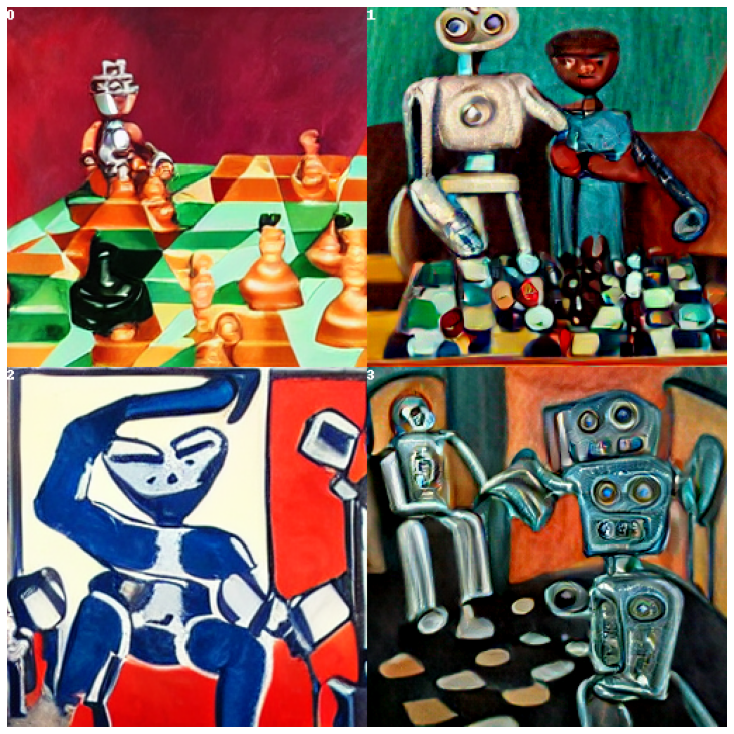

CPU times: user 1.06 s, sys: 1.16 s, total: 2.22 s
Wall time: 38.4 s


In [31]:
%%time

from docarray import Document

da = Document(text=prompt).post(server_url, parameters={'num_images': 2}).matches
da.plot_image_sprites(fig_size=(10,10), show_index=True)

Here we generate 4 candidates, 2 from DALLE-mega and 2 from GLID3 XL, this is as defined in `num_images`, which takes about ~2 minutes. You can use a smaller value if it is too long for you. The results are sorted by [CLIP-as-service](https://github.com/jina-ai/clip-as-service), with index-`0` as the best candidate judged by CLIP. 

> You could generate up to 8 images per pathway via `num_images`, resulting 16 candidate images in total. But it will be much slower.

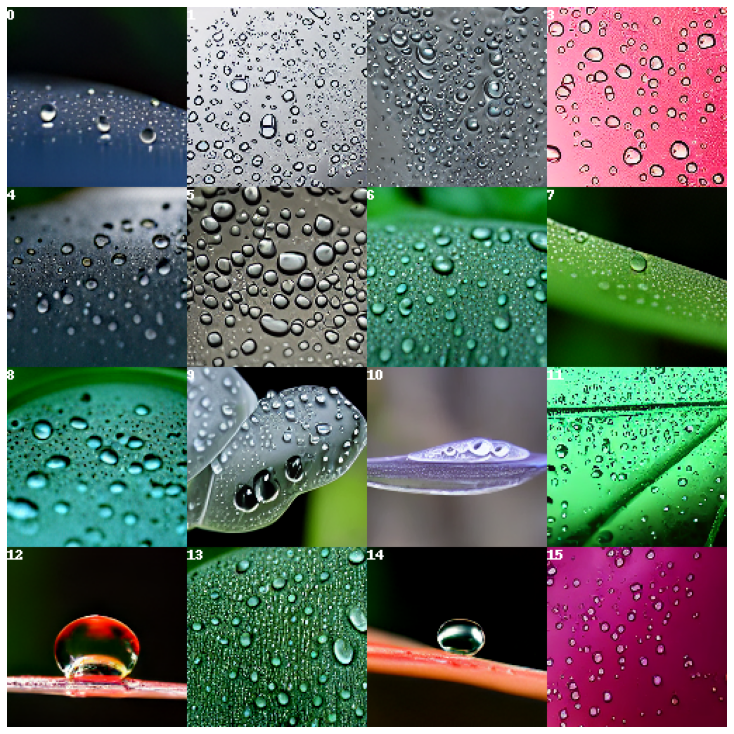

In [13]:
prompt = "droplets"
da = Document(text=prompt).post(server_url, parameters={'num_images': 8}).matches
da.plot_image_sprites(fig_size=(10,10), show_index=True)

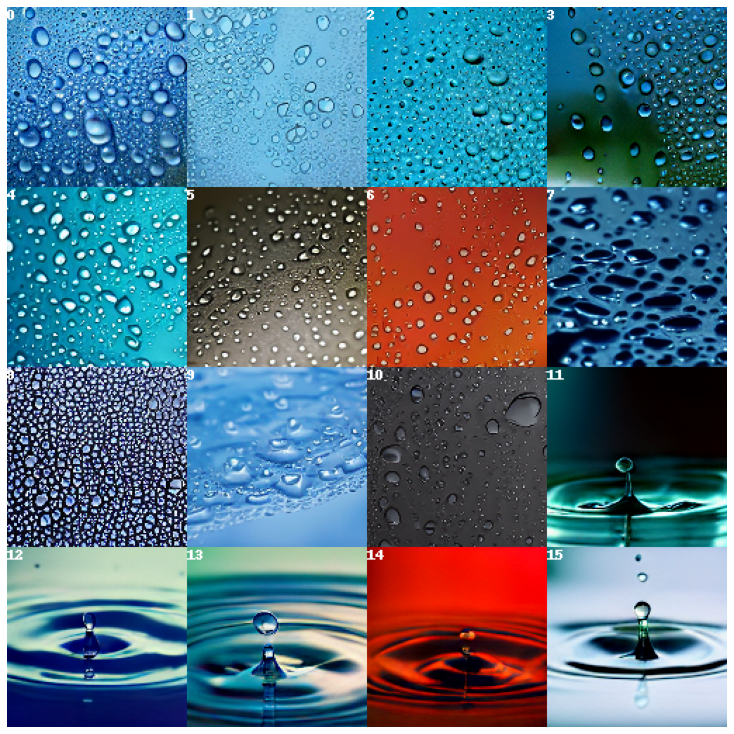

In [72]:
prompt = "water droplets"
da = Document(text=prompt).post(server_url, parameters={'num_images': 8}).matches
da.plot_image_sprites(fig_size=(10,10), show_index=True)

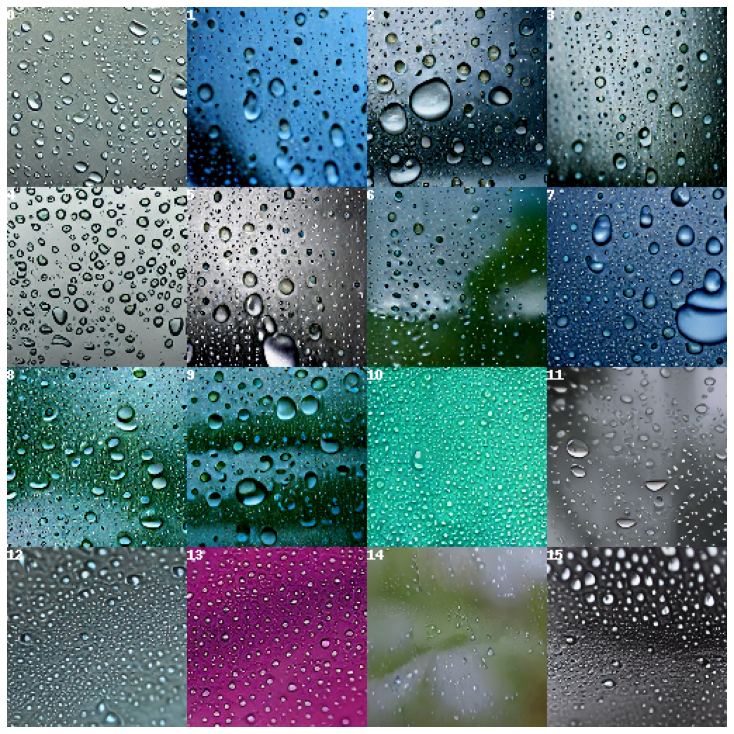

In [73]:
prompt = "rain droplets"
da = Document(text=prompt).post(server_url, parameters={'num_images': 8}).matches
da.plot_image_sprites(fig_size=(10,10), show_index=True)

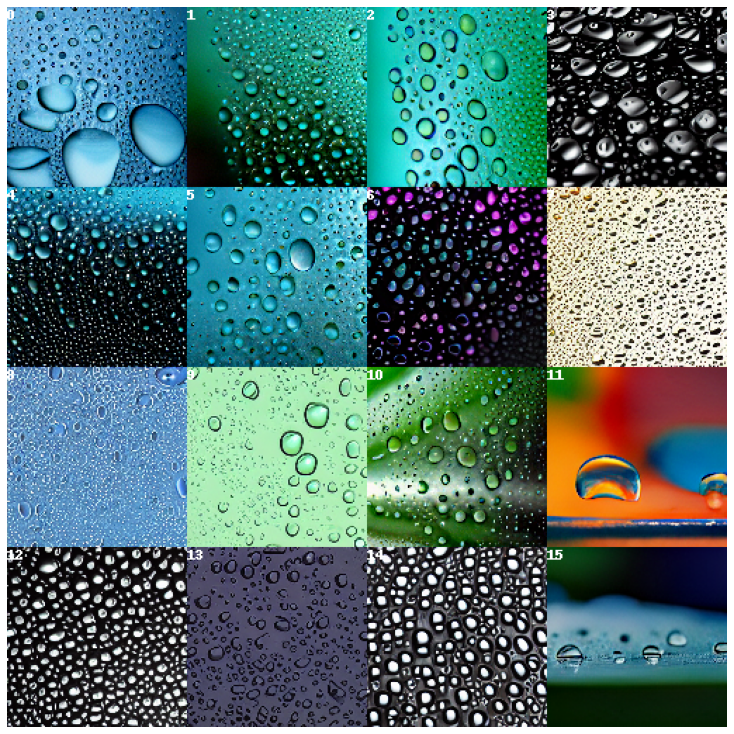

In [74]:
prompt = "abstract droplets"
da = Document(text=prompt).post(server_url, parameters={'num_images': 8}).matches
da.plot_image_sprites(fig_size=(10,10), show_index=True)

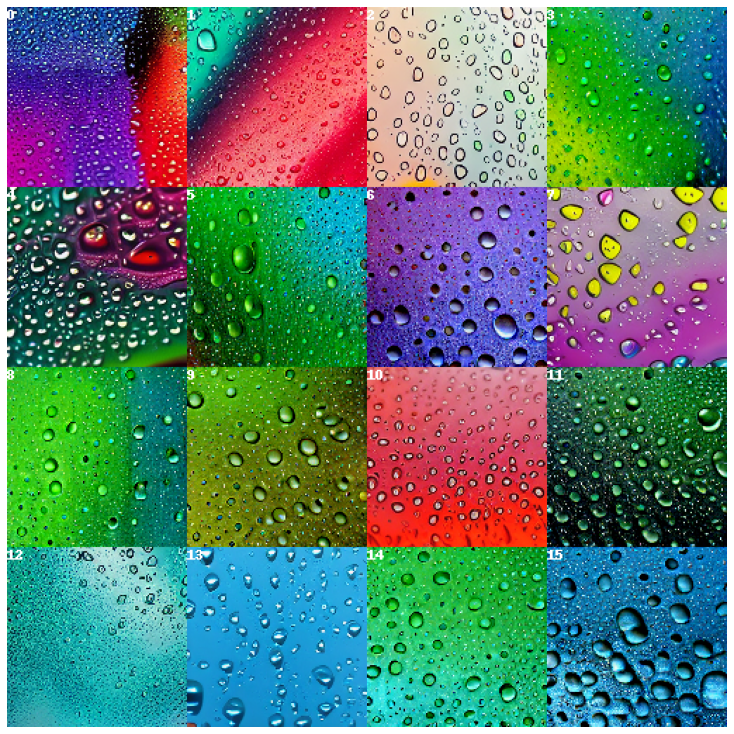

In [75]:
prompt = "colorful rain droplets"
da = Document(text=prompt).post(server_url, parameters={'num_images': 8}).matches
da.plot_image_sprites(fig_size=(10,10), show_index=True)

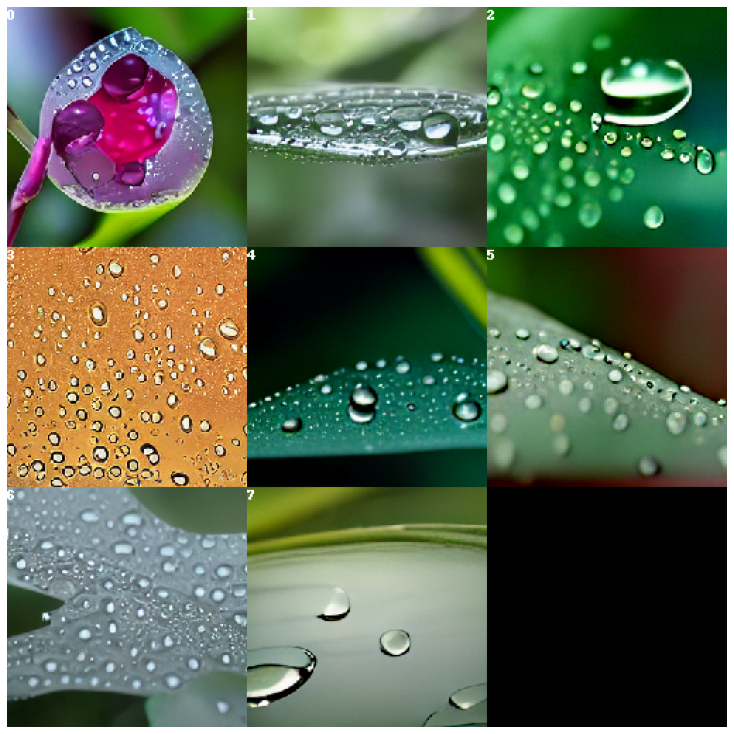

In [76]:
prompt = "beautiful droplets"
da = Document(text=prompt).post(server_url, parameters={'num_images': 4}).matches
da.plot_image_sprites(fig_size=(10,10), show_index=True)

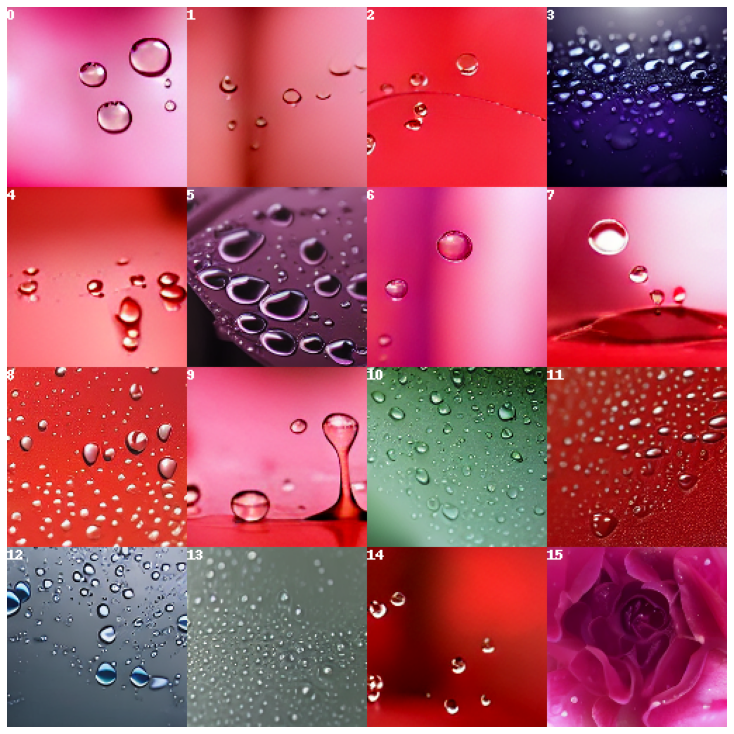

In [14]:
prompt = "romantic droplets"
da = Document(text=prompt).post(server_url, parameters={'num_images': 8}).matches
da.plot_image_sprites(fig_size=(10,10), show_index=True)

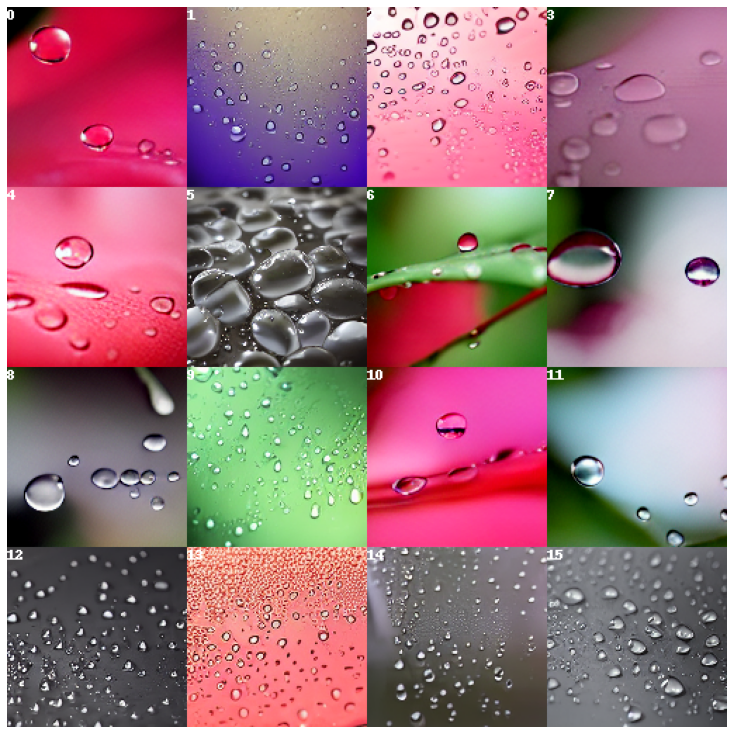

In [15]:
prompt = "droplets in romantic style"
da = Document(text=prompt).post(server_url, parameters={'num_images': 8}).matches
da.plot_image_sprites(fig_size=(10,10), show_index=True)

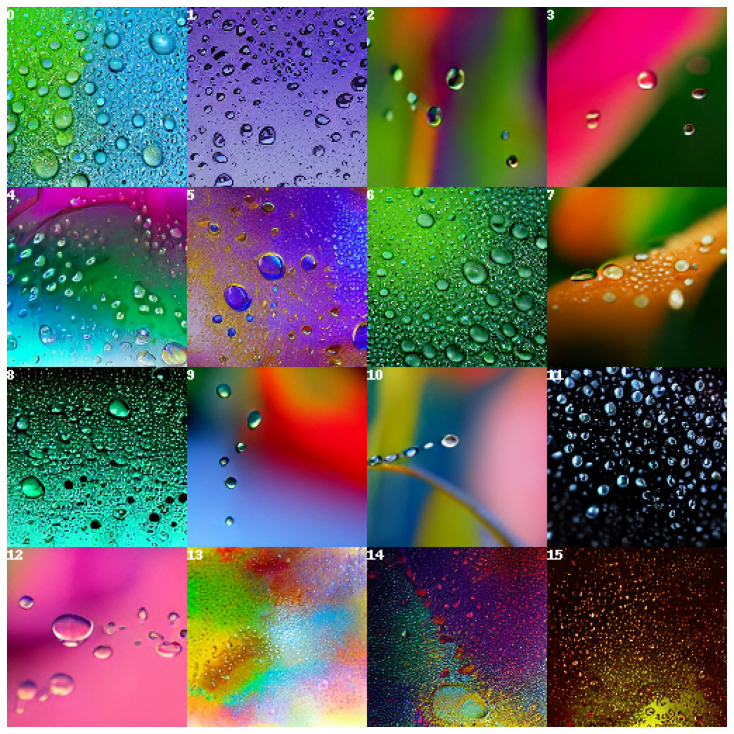

In [16]:
prompt = "droplets in impressionism style"
da = Document(text=prompt).post(server_url, parameters={'num_images': 8}).matches
da.plot_image_sprites(fig_size=(10,10), show_index=True)

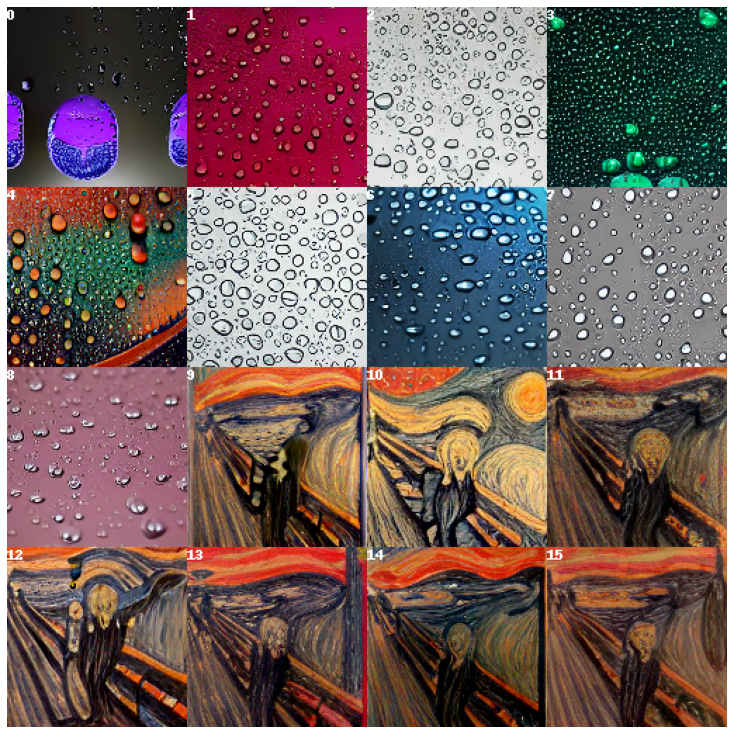

In [17]:
prompt = "droplets in expressionist style"
da = Document(text=prompt).post(server_url, parameters={'num_images': 8}).matches
da.plot_image_sprites(fig_size=(10,10), show_index=True)

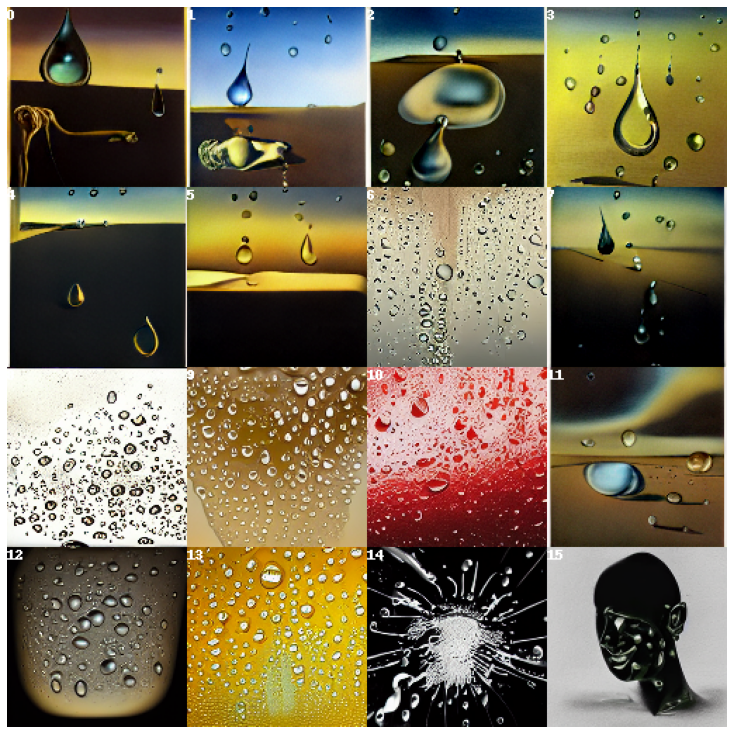

In [18]:
prompt = "droplets by Salvador Dali"
da = Document(text=prompt).post(server_url, parameters={'num_images': 8}).matches
da.plot_image_sprites(fig_size=(10,10), show_index=True)

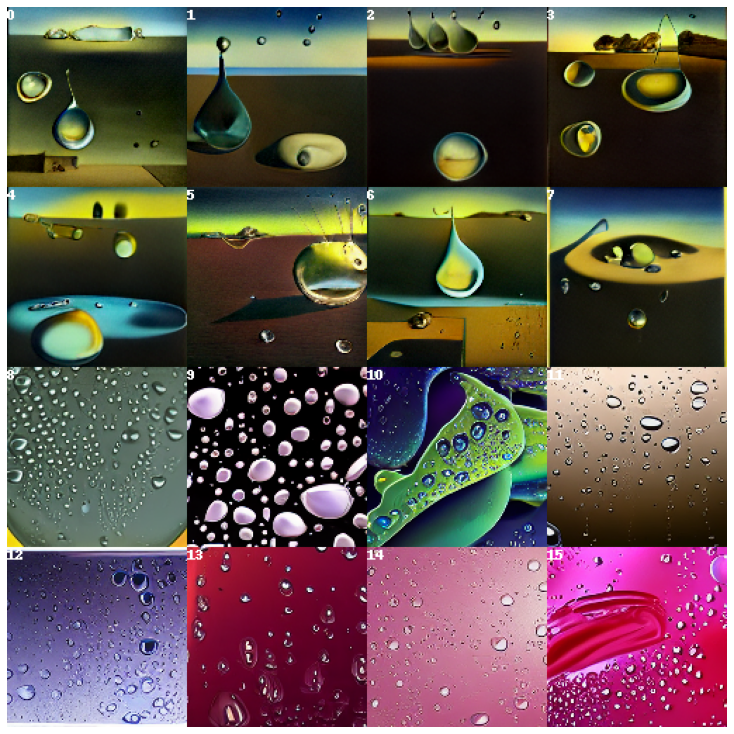

In [19]:
prompt = "droplets by Dali"
da = Document(text=prompt).post(server_url, parameters={'num_images': 8}).matches
da.plot_image_sprites(fig_size=(10,10), show_index=True)

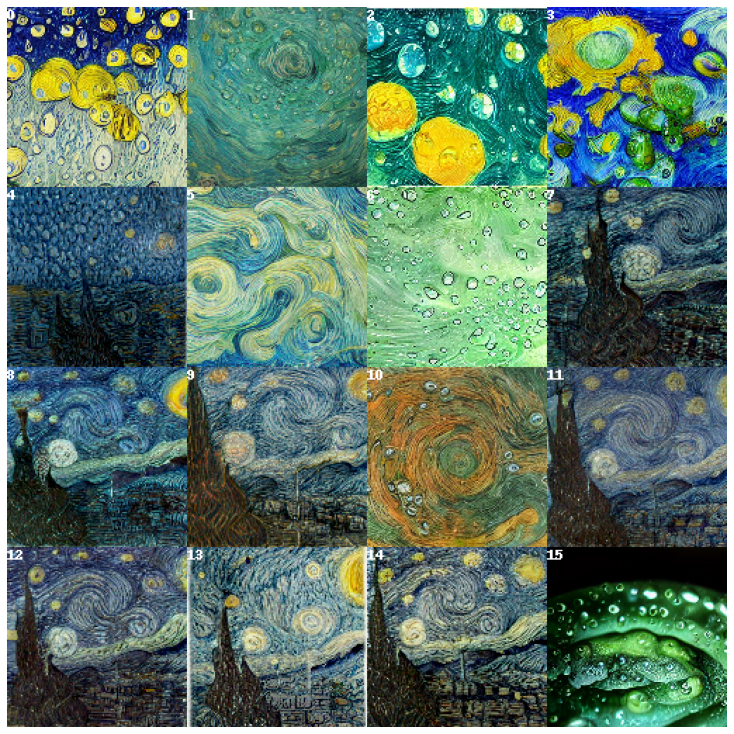

In [20]:
prompt = "droplets by Van Gogh"
da = Document(text=prompt).post(server_url, parameters={'num_images': 8}).matches
da.plot_image_sprites(fig_size=(10,10), show_index=True)

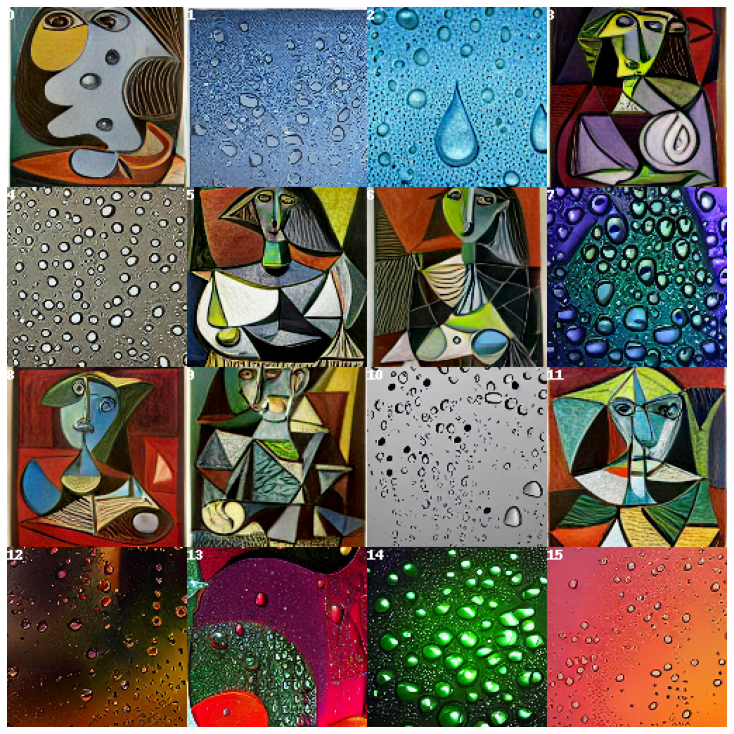

In [21]:
prompt = "droplets by Picasso"
da = Document(text=prompt).post(server_url, parameters={'num_images': 8}).matches
da.plot_image_sprites(fig_size=(10,10), show_index=True)

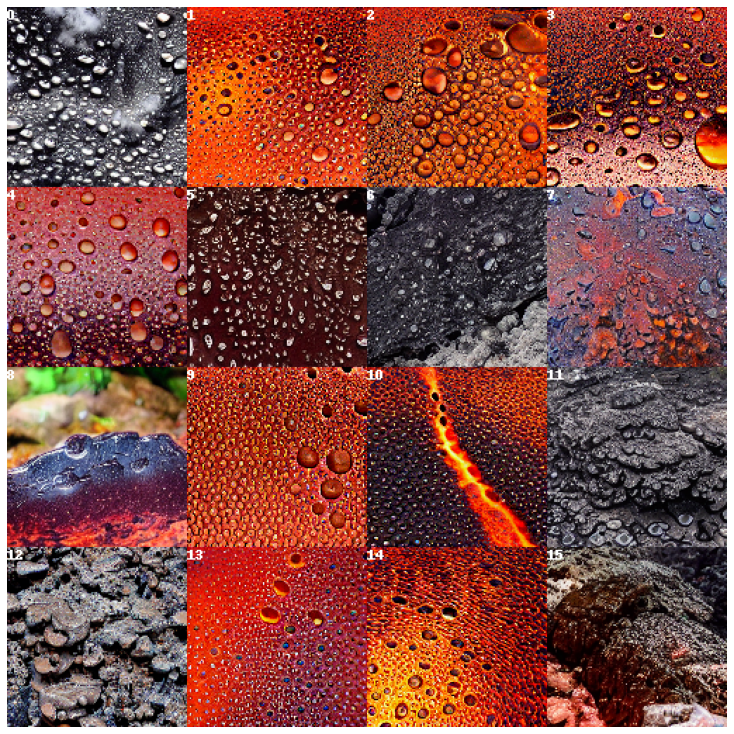

In [25]:
prompt = "droplets made out of lava"
da = Document(text=prompt).post(server_url, parameters={'num_images': 8}).matches
da.plot_image_sprites(fig_size=(10,10), show_index=True)

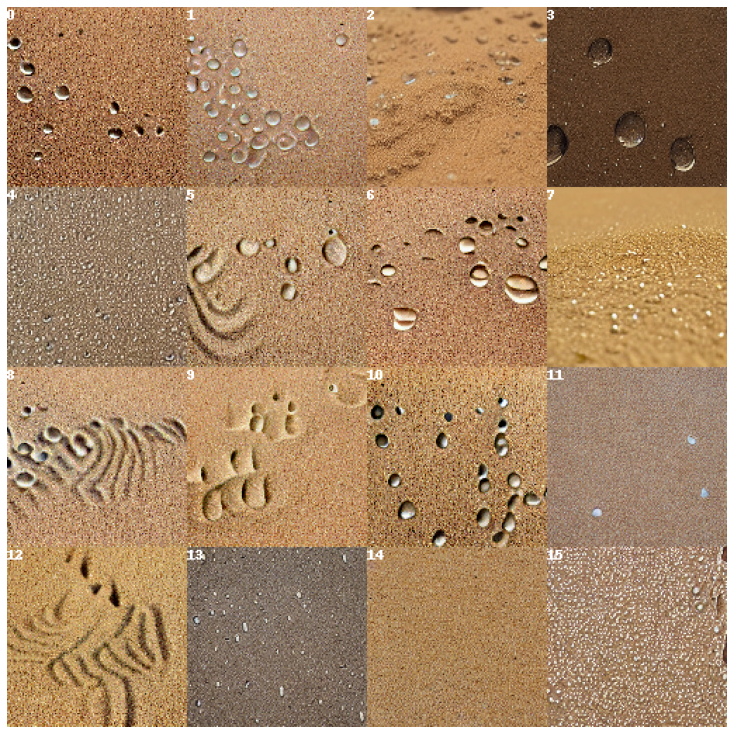

In [22]:
prompt = "droplets made out of sand"
da = Document(text=prompt).post(server_url, parameters={'num_images': 8}).matches
da.plot_image_sprites(fig_size=(10,10), show_index=True)

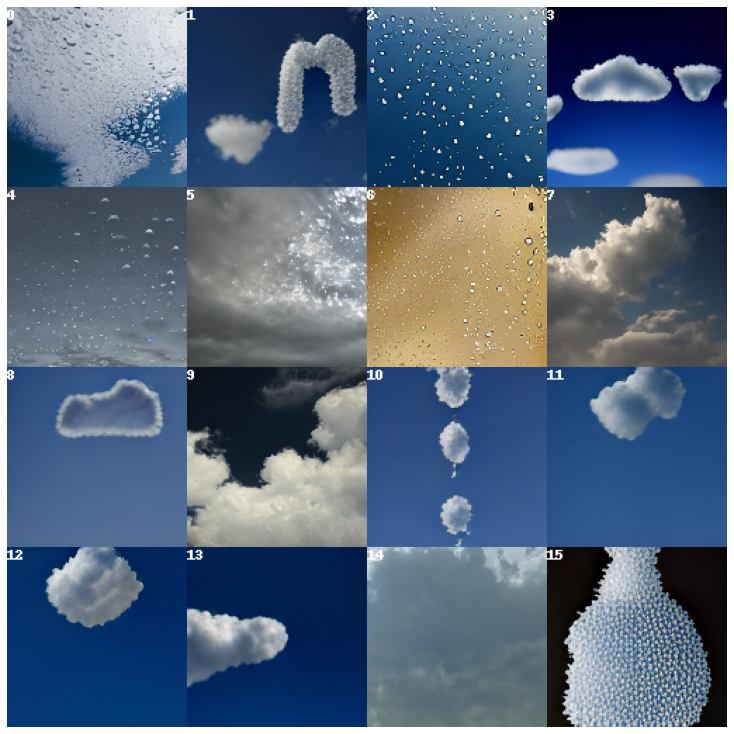

In [23]:
prompt = "droplets made out of clouds"
da = Document(text=prompt).post(server_url, parameters={'num_images': 8}).matches
da.plot_image_sprites(fig_size=(10,10), show_index=True)

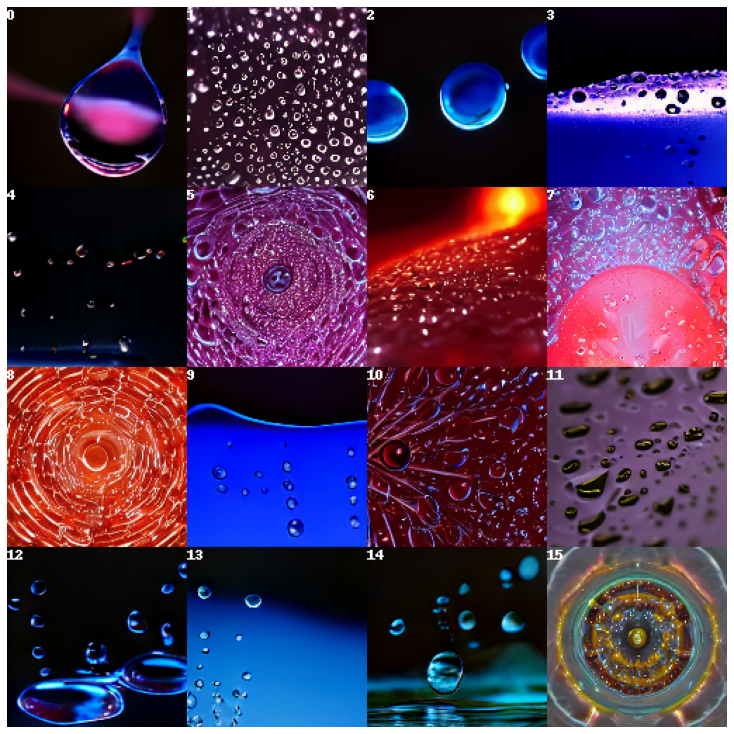

In [24]:
prompt = "droplets made out of plasma"
da = Document(text=prompt).post(server_url, parameters={'num_images': 8}).matches
da.plot_image_sprites(fig_size=(10,10), show_index=True)

In [ ]:
prompt = "droplets made out of plasma"
da = Document(text=prompt).post(server_url, parameters={'num_images': 2}).matches
da.plot_image_sprites(fig_size=(10,10), show_index=True)

In [ ]:

prompt = "droplets made out of plasma"
da = Document(text=prompt).post(server_url, parameters={'num_images': 1}).matches
da.plot_image_sprites(fig_size=(10,10), show_index=True)

In [88]:
import random
def random_string(length=20):
    return ''.join(random.choice('0123456789ABCDEF') for i in range(length))

def generate_images(prompt,):
    da = Document(text=prompt).post(server_url, parameters={'num_images': 8}).matches
    for img in da:
        # upscale it to 1024 x 1024
        img = img.post(f'{server_url}/upscale')
        # save to file 
        img.save_uri_to_file(f'out/{random_string()}.png')


prompts = [
    'droplets',
    'droplets',
    'droplets',
    'droplets',
    'droplets',
    'droplets',
    'droplets',
    'water droplets',
    'water droplets',
    'water droplets',
    'water droplets',
    'water droplets',
    'lava rain droplets',
    'sand rain droplets',
    'rain droplets',
    'abstract droplets',
    'colorful rain droplets',
    'beautiful droplets',
    'romantic droplets',
    'droplets in romantic style',
    'droplets in impressionism style',
    'droplets in expressionist style',
]
authors = ["Toshi Yoshida", "Hiroshi Yoshida", "Ivan Bilibin", "Ivan Shishkin", "Kuniyoshi", "Ghibli", "h r giger"]
prompts_authors = ['droplets' + ' by ' + author for author in authors]
prompts.extend(prompts_authors)


import os
if not os.path.exists('out'):
    os.makedirs('out')


# shuffle the prompts
random.shuffle(prompts)
n = 1000
while n > 0:
    for prompt in prompts:
        generate_images(prompt)
        print(prompt)
        print('\n')
        n -= 16
        if n <= 0:
            break

Exception in callback PollerCompletionQueue._handle_events(<_UnixSelecto...e debug=False>)()
handle: <Handle PollerCompletionQueue._handle_events(<_UnixSelecto...e debug=False>)()>
Traceback (most recent call last):
  File "/usr/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "src/python/grpcio/grpc/_cython/_cygrpc/aio/completion_queue.pyx.pxi", line 147, in grpc._cython.cygrpc.PollerCompletionQueue._handle_events
BlockingIOError: [Errno 11] Resource temporarily unavailable
Exception in callback PollerCompletionQueue._handle_events(<_UnixSelecto...e debug=False>)()
handle: <Handle PollerCompletionQueue._handle_events(<_UnixSelecto...e debug=False>)()>
Traceback (most recent call last):
  File "/usr/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "src/python/grpcio/grpc/_cython/_cygrpc/aio/completion_queue.pyx.pxi", line 147, in grpc._cython.cygrpc.PollerCompletionQu

Exception in callback PollerCompletionQueue._handle_events(<_UnixSelecto...e debug=False>)()
handle: <Handle PollerCompletionQueue._handle_events(<_UnixSelecto...e debug=False>)()>
Traceback (most recent call last):
  File "/usr/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "src/python/grpcio/grpc/_cython/_cygrpc/aio/completion_queue.pyx.pxi", line 147, in grpc._cython.cygrpc.PollerCompletionQueue._handle_events
BlockingIOError: [Errno 11] Resource temporarily unavailable
Exception in callback PollerCompletionQueue._handle_events(<_UnixSelecto...e debug=False>)()
handle: <Handle PollerCompletionQueue._handle_events(<_UnixSelecto...e debug=False>)()>
Traceback (most recent call last):
  File "/usr/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "src/python/grpcio/grpc/_cython/_cygrpc/aio/completion_queue.pyx.pxi", line 147, in grpc._cython.cygrpc.PollerCompletionQu

KeyboardInterrupt: 

### Step 2: Select and refinement via GLID3 XL

Of course, you may think differently. Notice the number in the top-left corner? Select the one you like the most and get a better view:

In [ ]:
fav_id = 3

fav = da[fav_id]

fav.display()

Now let's submit the selected candidates to the server for diffusion.

In [ ]:
%%time

diffused = fav.post(f'{server_url}', parameters={'skip_rate': 0.6, 'num_images': 4}, target_executor='diffusion').matches

diffused.plot_image_sprites(fig_size=(10,10), show_index=True)

This will give 4 images based on the given image. You may allow the model to improvise more by giving `skip_rate` a near-zero value, or a near-one value to force its closeness to the given image. The whole procedure takes about ~1 minutes.

> You could generate upto 8 images via `num_images`. But it will be slower.

### Step 3: Select and upscale via SwinIR

Select the image you like the most, and give it a closer look:


In [ ]:
dfav_id = 2

fav = diffused[dfav_id]

fav.display()

If not satisfied, you can rerun the last cell in step 2 with this new `fav`.

Finally, submit to the server for the last step: upscaling to 1024 x 1024px.

> This step should be much faster (~10s) as the Flow is designed in unblocked manner.

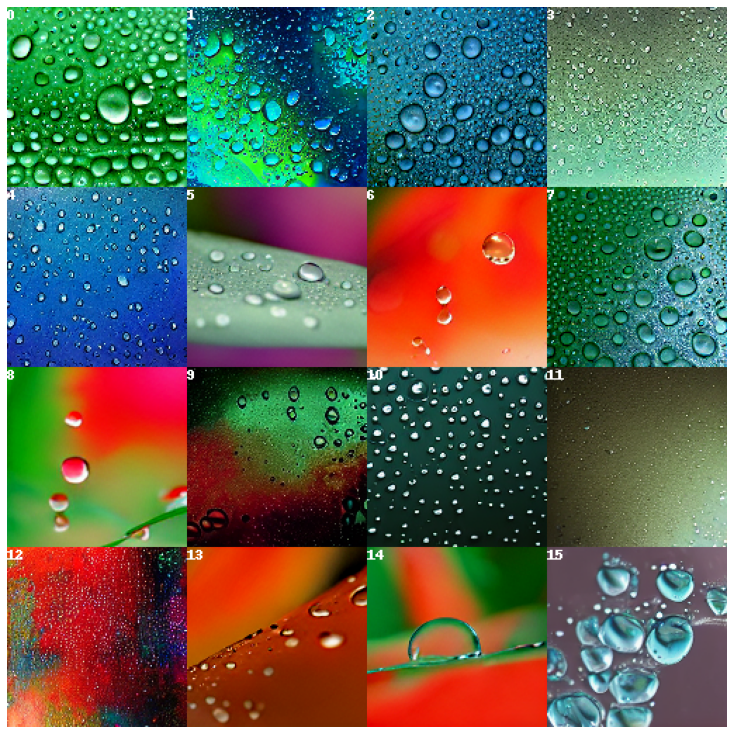

CPU times: user 1.52 s, sys: 437 ms, total: 1.96 s
Wall time: 2min 35s


📄 Document: 4dd4fa9fea0d5ce1979fef732eb426a4
╭───────────┬──────────────────────────────────────────────────────────────────╮
│ Attribute │ Value                                                            │
├───────────┼──────────────────────────────────────────────────────────────────┤
│ adjacency │ 1                                                                │
│ mime_type │ image/png                                                        │
│ text      │ droplets in impressionism style                                  │
│ uri       │ data:image/png;charset=utf-8,%89PNG%0D%0A%1A%0A%00%00%00%0DIHDR… │
│           │ (length: 4108899)                                                │
│ tags      │ {'task': 'real_sr', 'folder_lq':                                 │
│           │ '../SwinIR/input/4dd4fa9fea0d5ce1979fef732eb426a4/', 'text':     │
│           │ 'droplets in impressionism style', 'model_path':                 │
│           │ 'model_zoo/swinir/003_realSR_BSRGAN_DFOWMFC_s64w8_SwinIR-L_x4_G… │
│           │ 'upscaled': True, 'generator': 'DALLE-mega', 'scale': 4.0,       │
│           │ 'created_time': 1658711929.2715046, 'request_time':              │
│           │ 1658711882.9798677, 'finish_time': 1658712023.8134525}           │
│ scores    │ defaultdict(<class 'docarray.score.NamedScore'>,                 │
│           │ {'clip_score_cosine': {'value': 0.2908288240432739, 'op_name':   │
│           │ 'cosine'}, 'clip_score': {'value': 0.2863050401210785,           │
│           │ 'op_name': 'softmax'}})                                          │
╰───────────┴──────────────────────────────────────────────────────────────────╯

In [95]:
%%time
prompt = "droplets in impressionism style"
da = Document(text=prompt).post(server_url, parameters={'num_images': 8}).matches
da.plot_image_sprites(fig_size=(10,10), show_index=True)

fav = da[0]
fav = fav.post(f'{server_url}/upscale')
fav.display()
fav.save_uri_to_file('out/fav2.png')

In [91]:
fav.save_uri_to_file('out/fav.png')

📄 Document: 7a315947dd3e45506ec5ac206a31868a
╭───────────┬──────────────────────────────────────────────────────────────────╮
│ Attribute │ Value                                                            │
├───────────┼──────────────────────────────────────────────────────────────────┤
│ adjacency │ 1                                                                │
│ mime_type │ image/png                                                        │
│ text      │ droplets made out of plasma                                      │
│ uri       │ data:image/png;charset=utf-8,%89PNG%0D%0A%1A%0A%00%00%00%0DIHDR… │
│           │ (length: 4077707)                                                │
│ tags      │ {'skip_timesteps': 0.0, 'batch_size': 9.0, 'init_image': None,   │
│           │ 'output_path': '606a52ebcb35f684ad39c580bcfc2b66',               │
│           │ 'num_batches': 1.0, 'finish_time': 1658711777.5671034,           │
│           │ 'created_time': 1658710868.2375734, 'generator': 'GLID3-XL',     │
│           │ 'scale': 4.0, 'upscaled': True, 'text': '"droplets made out of   │
│           │ plasma"', 'steps': 100.0, 'folder_lq':                           │
│           │ '../SwinIR/input/7a315947dd3e45506ec5ac206a31868a/',             │
│           │ 'request_time': 1658710825.0888314, 'model_path':                │
│           │ 'model_zoo/swinir/003_realSR_BSRGAN_DFOWMFC_s64w8_SwinIR-L_x4_G… │
│           │ 'task': 'real_sr'}                                               │
│ scores    │ defaultdict(<class 'docarray.score.NamedScore'>, {'clip_score':  │
│           │ {'value': 0.40304112434387207, 'op_name': 'softmax'},            │
│           │ 'clip_score_cosine': {'value': 0.2709217667579651, 'op_name':    │
│           │ 'cosine'}})                                                      │
╰───────────┴──────────────────────────────────────────────────────────────────╯

In [94]:
da[6].display()

In [83]:
a = da[0]
a.save_uri_to_file('test.png')

📄 Document: 7a315947dd3e45506ec5ac206a31868a
╭───────────┬──────────────────────────────────────────────────────────────────╮
│ Attribute │ Value                                                            │
├───────────┼──────────────────────────────────────────────────────────────────┤
│ adjacency │ 1                                                                │
│ mime_type │ image/png                                                        │
│ text      │ droplets made out of plasma                                      │
│ uri       │ data:image/png;charset=utf-8,%89PNG%0D%0A%1A%0A%00%00%00%0DIHDR… │
│           │ (length: 374960)                                                 │
│ tags      │ {'batch_size': 9.0, 'text': '"droplets made out of plasma"',     │
│           │ 'created_time': 1658710868.2375734, 'steps': 100.0,              │
│           │ 'output_path': '606a52ebcb35f684ad39c580bcfc2b66',               │
│           │ 'num_batches': 1.0, 'request_time': 1658710825.0888314,          │
│           │ 'generator': 'GLID3-XL', 'skip_timesteps': 0.0, 'init_image':    │
│           │ None}                                                            │
│ scores    │ defaultdict(<class 'docarray.score.NamedScore'>,                 │
│           │ {'clip_score_cosine': {'value': 0.2709217667579651, 'op_name':   │
│           │ 'cosine'}, 'clip_score': {'value': 0.40304112434387207,          │
│           │ 'op_name': 'softmax'}})                                          │
╰───────────┴──────────────────────────────────────────────────────────────────╯

> 💁‍♂️ On Google colab this image may render exactly the same size as before. But it is in 1024x1024 already. Right click on the image and copy/save it. You will see.

That's it! It is _the one_.


Btw, [DocArray is a powerful and easy-to-use data structure for unstructured data](https://github.com/jina-ai/docarray), that makes all of these possible. It is super productive for data scientists who work in cross-/multi-modal domain. To learn more about DocArray, [please check out the docs](https://docarray.jina.ai).